<a href="https://colab.research.google.com/github/AndreassOlsson/drone-anomalydetection/blob/main/videodata_exploration_minidrone.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import cv2
import matplotlib.pyplot as plt

from glob import glob


from IPython.display import HTML
from base64 import b64encode
from tqdm import tqdm

import subprocess

import bisect
import json
import ast

plt.style.use('ggplot')

### Load a video with ffmpeg subprocess

In [ ]:
video_path = '/content/drive/MyDrive/Andreas Olsson/Public-Safety/data/minidrone/DroneProtect-testing-set/Attack_CloseUp_Day_Empty_1_2_1.mp4'
subprocess.run(['ffmpeg',
                '-i',
                video_path,
                '-qscale',
                '0',
                'test.mp4',
                '-loglevel',
                'quiet'])

CompletedProcess(args=['ffmpeg', '-i', '/content/drive/MyDrive/Andreas Olsson/Public-Safety/data/minidrone/DroneProtect-testing-set/Attack_CloseUp_Day_Empty_1_2_1.mp4', '-qscale', '0', 'test.mp4', '-loglevel', 'quiet'], returncode=0)

### Inspect video

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = "test.mp4"

# Compressed video path
compressed_path = "test_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [ ]:
cap = cv2.VideoCapture('test.mp4')

In [ ]:
cap = cv2.VideoCapture('/content/drive/MyDrive/Andreas Olsson/Public-Safety/data/minidrone/DroneProtect-training-set/BadParking_CloseUp_Day_Empty_1_0_1.mp4')

In [ ]:
fs = cap.get(cv2.CAP_PROP_FRAME_COUNT)
fps = cap.get(cv2.CAP_PROP_FPS)
height = cap.get(cv2.CAP_PROP_FRAME_HEIGHT)
width = cap.get(cv2.CAP_PROP_FRAME_WIDTH)
print(f'Frames {fs}, FPS {fps}, Height {height}, Width {width}')

Frames 480.0, FPS 29.972, Height 1080.0, Width 1920.0


In [ ]:
cap.release()

### Extract images from video

In [ ]:
video_path = '/content/drive/MyDrive/Andreas Olsson/Public-Safety/data/minidrone/DroneProtect-training-set/BadParking_CloseUp_Day_Empty_1_0_1.mp4'
cap = cv2.VideoCapture(video_path)
res, img = cap.read()
print(res, img.shape)

True (1080, 1920, 3)


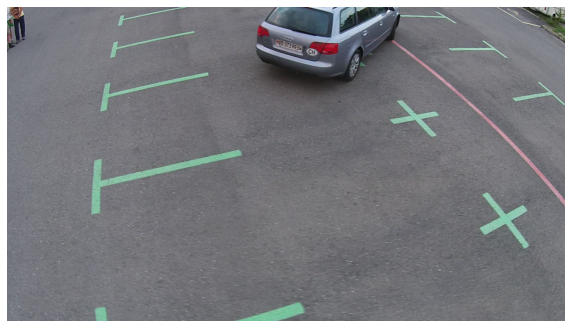

In [ ]:
def display_cv2_img(img, figsize=(10,10)):
  img_ = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  fig, ax = plt.subplots(figsize=figsize)
  ax.imshow(img_)
  ax.axis('off')

display_cv2_img(img)

In [ ]:
cap.release()

### Display multiple frames

In [ ]:
def display_multiple_frames(video_path, n_frames=10, starting_frame=0, interval=30, n_cols=5):
  cap = cv2.VideoCapture(video_path)
  n_frames_total = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

  frames = [starting_frame + interval * i for i in range(n_frames) if starting_frame + interval * i <= n_frames_total]
  n_frames = len(frames)

  n_rows = bisect.bisect_right([i for i in range(n_frames) if i % n_cols == 0], n_frames)
  fig, axs = plt.subplots(n_rows, n_cols, figsize=(20, n_rows * 3))
  axs = axs.flatten()

  for i, frame in enumerate(frames):
      cap.set(cv2.CAP_PROP_POS_FRAMES, frame)
      res, img = cap.read()
      if res:
          axs[i].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
          axs[i].set_title(f'Frame: {frame}')
          axs[i].axis('off')

  plt.tight_layout()
  plt.show()
  cap.release()

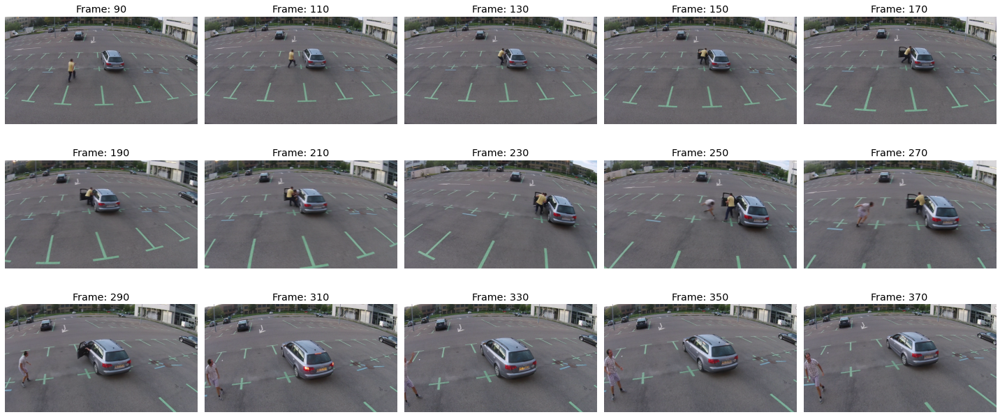

In [ ]:
display_multiple_frames('test.mp4', n_frames=15, starting_frame=90, interval=20)

### Explore annotations

In [ ]:
doc_path = '/content/drive/MyDrive/Andreas Olsson/Public-Safety/data/minidrone/DroneProtect-testing-set/Attack_CloseUp_Day_Empty_1_2_1.xgtf'

In [ ]:
!pip install xmltodict

In [ ]:
from bs4 import BeautifulSoup
import xmltodict

In [ ]:
with open(doc_path, 'r') as f:
  xml = f.read()
  d = xmltodict.parse(f"""{xml}""")

In [ ]:
objs = d['viper']['data']['sourcefile']['object']
a = {f"{k['@name']}_id{idx}" : [i['@name'] for i in objs[idx]['attribute']] for idx, k in enumerate(list(objs))}; a

{'Vehicle_id0': ['obox',
  'Color',
  'View',
  'Sticker',
  'Action',
  'Privacy',
  'Type'],
 'Person_id1': ['box',
  'Ethnicity',
  'Gender',
  'Visibility',
  'Action',
  'Privacy',
  'Age',
  'Role',
  'Color'],
 'Person_id2': ['box',
  'Ethnicity',
  'Gender',
  'Visibility',
  'Action',
  'Privacy',
  'Age',
  'Role',
  'Color'],
 'LicensePlate_id3': ['obox', 'Number', 'Privacy'],
 'Face_id4': ['left-eye', 'right-eye', 'nose', 'box', 'person_id', 'privacy']}

In [ ]:
objs[0]['attribute'][6]

{'@name': 'Type', 'data:lvalue': {'@value': 'car'}}

### Separate anomalies

In [ ]:
import os

In [ ]:
train = ('/content/drive/MyDrive/Andreas Olsson/Public-Safety/data/minidrone/DroneProtect-training-set/')
test = ('/content/drive/MyDrive/Andreas Olsson/Public-Safety/data/minidrone/DroneProtect-testing-set/')
normal = [train+filename for filename in os.listdir(train) if 'Normal' in filename and filename.endswith(".mp4")] + [test+filename for filename in os.listdir(test) if 'Normal' in filename and filename.endswith(".mp4")]
anomalies = [train+filename for filename in os.listdir(train) if not 'Normal' in filename and filename.endswith(".mp4")] + [test+filename for filename in os.listdir(test) if not 'Normal' in filename and filename.endswith(".mp4")]
print(f'Normal ex: {normal[0]}\nAnomaly ex: {anomalies[0]}\nCombined length: {len(normal + anomalies)}')

Normal ex: /content/drive/MyDrive/Andreas Olsson/Public-Safety/data/minidrone/DroneProtect-training-set/Normal_Static_Day_Half_0_2_1.mp4
Anomaly ex: /content/drive/MyDrive/Andreas Olsson/Public-Safety/data/minidrone/DroneProtect-training-set/Suspicious_Static_Day_Half_0_2_2.mp4
Combined length: 37


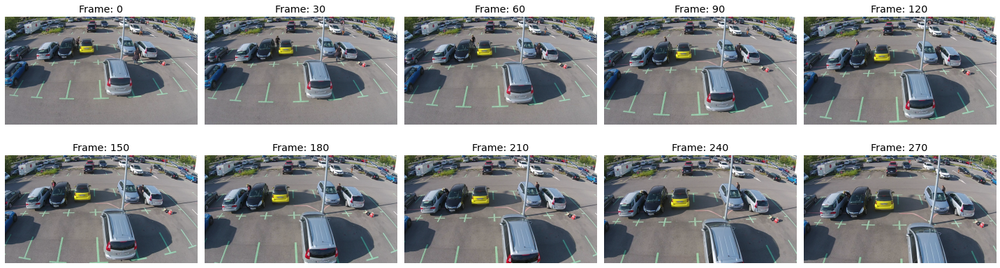

In [ ]:
display_multiple_frames(anomalies[0])